In [1]:
# cv2: OpenCV 라이브러리로, 실시간 컴퓨터 비전을 목적으로 한 프로그래밍 라이브러리
# torch: PyTorch. 딥러닝 및 텐서 연산을 위한 라이브러리. 인공지능 모델을 만들거나 불러와 추론하는 도구
# torchvision: 이미지 변환 및 전처리를 위한 torchvision의 transform 모듈
# deeplabv3_resnet101: 사전 학습된 DeepLabV3 모델. 이미지를 분류하도록 학습된 모델

import cv2
import os
import numpy as np
import torch
import torchvision.transforms as T
from torchvision.models.segmentation import deeplabv3_resnet101
import matplotlib.pyplot as plt

print('슝=3')

슝=3


# 1. 사진 준비하기

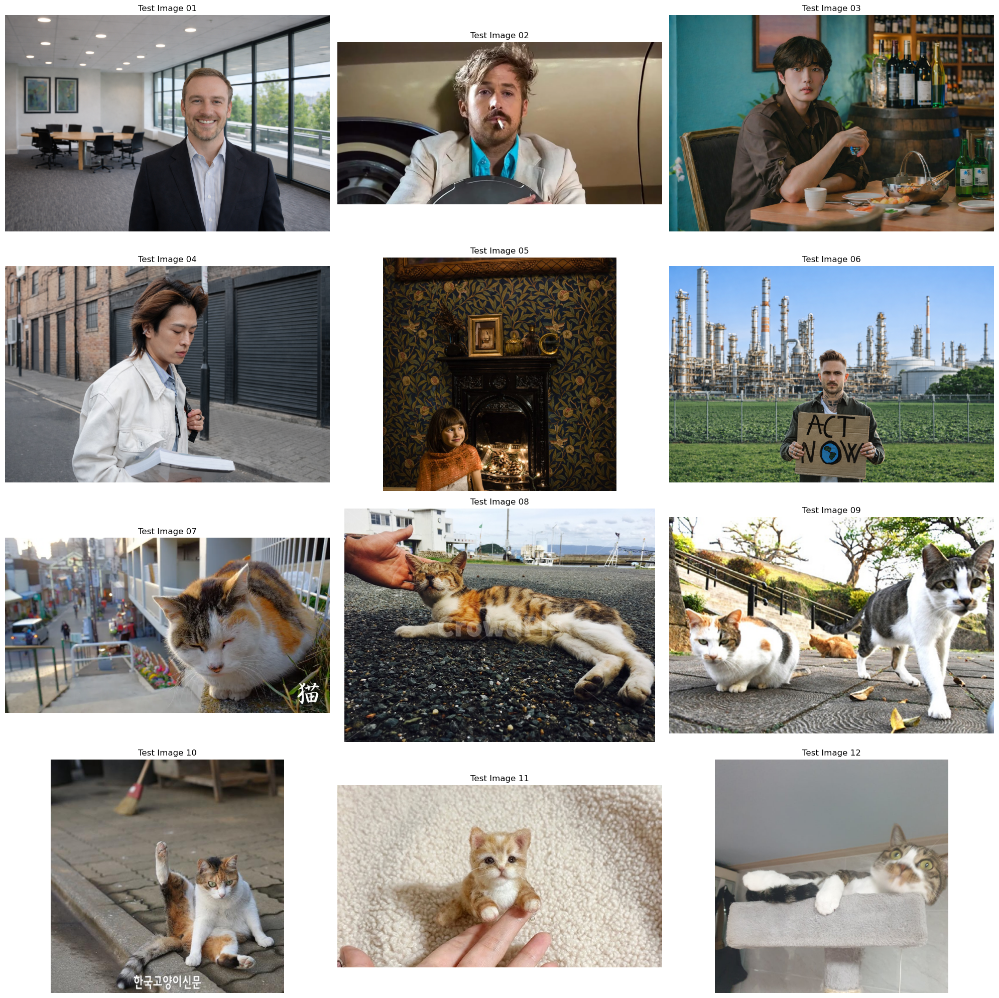

In [2]:
img_list = []

for i in range(1, 13):
    img_path = f'test_images/test_image_{i:02d}.png'
    img_list.append(cv2.imread(img_path))

fig, axes = plt.subplots(4, 3, figsize=(20, 20))
for ax, img, i in zip(axes.flatten(), img_list, range(1, 13)):
    ax.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
    ax.set_title(f'Test Image {i:02d}')
    ax.axis('off')
plt.tight_layout()
plt.show()

배경(사막) 이미지 크기: (600, 800, 3)


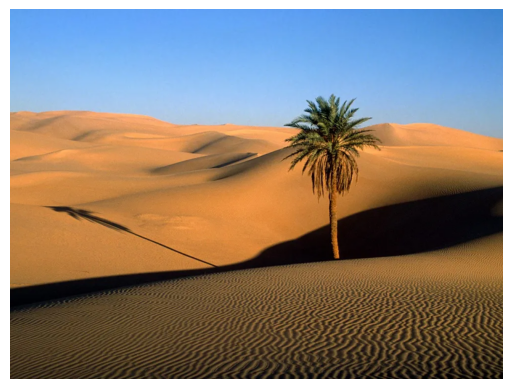

In [3]:
sand_img_path = "test_images/desert.png"
sand_img = cv2.imread(sand_img_path)
sand_img = cv2.cvtColor(sand_img, cv2.COLOR_BGR2RGB)
print(f"배경(사막) 이미지 크기: {sand_img.shape}")

plt.imshow(sand_img)
plt.axis('off')
plt.show()

# 2. 시멘틱 세그멘테이션 함수 정의하기

In [4]:
def segmentation(img_orig, label_ID):
    model = deeplabv3_resnet101(pretrained=True).eval()

    transform = T.Compose([
        T.ToPILImage(),
        T.Resize((520, 520)),  # 모델 입력 크기 (고정)
        T.ToTensor(),
    ])
    
    input_tensor = transform(cv2.cvtColor(img_orig, cv2.COLOR_BGR2RGB)).unsqueeze(0)

    with torch.no_grad():
        output = model(input_tensor)["out"][0]
        output_predictions = output.argmax(0).byte().cpu().numpy()

    # 원본 크기로 Resize
    output_predictions_resized = cv2.resize(output_predictions, (img_orig.shape[1], img_orig.shape[0]), interpolation=cv2.INTER_NEAREST)

    #컬러맵 만들기
    colormap = np.zeros((256, 3), dtype=int)
    ind = np.arange(256, dtype=int)

    for shift in reversed(range(8)):
        for channel in range(3):
            colormap[:, channel] |= ((ind >> channel) & 1) << shift
        ind >>= 3

    colormap[:20] # 생성한 20개의 컬러맵 출력

    colormap[label_ID] #컬러맵 label_ID에 해당하는 배열 출력

    # output의 픽셀 별로 예측된 class가 사람이라면 1(True), 다르다면 0(False)이 됩니다
    # 1과 0에 각각 255를 곱하였으므로 사람으로 예측된 픽셀은 255, 그렇지 않은 픽셀은 0
    # cmap 값을 변경하면 다른 색상으로 확인이 가능함
    seg_map = (output_predictions_resized == label_ID)  # 클래스 ID
    img_mask = seg_map.astype(np.uint8) * 255  # 255 값으로 변환
    color_mask = cv2.applyColorMap(img_mask, cv2.COLORMAP_JET)

    # 원본 이미지와 마스트를 적당히 합쳐봅니다
    # 0.6과 0.4는 두 이미지를 섞는 비율입니다.

    img_show = cv2.addWeighted(img_orig, 0.6, color_mask, 0.4, 0.0)

    return img_mask, img_show

# 3. 테스트 이미지 시멘틱 세그멘테이션

/opt/conda/lib/python3.12/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/opt/conda/lib/python3.12/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=DeepLabV3_ResNet101_Weights.COCO_WITH_VOC_LABELS_V1`. You can also use `weights=DeepLabV3_ResNet101_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


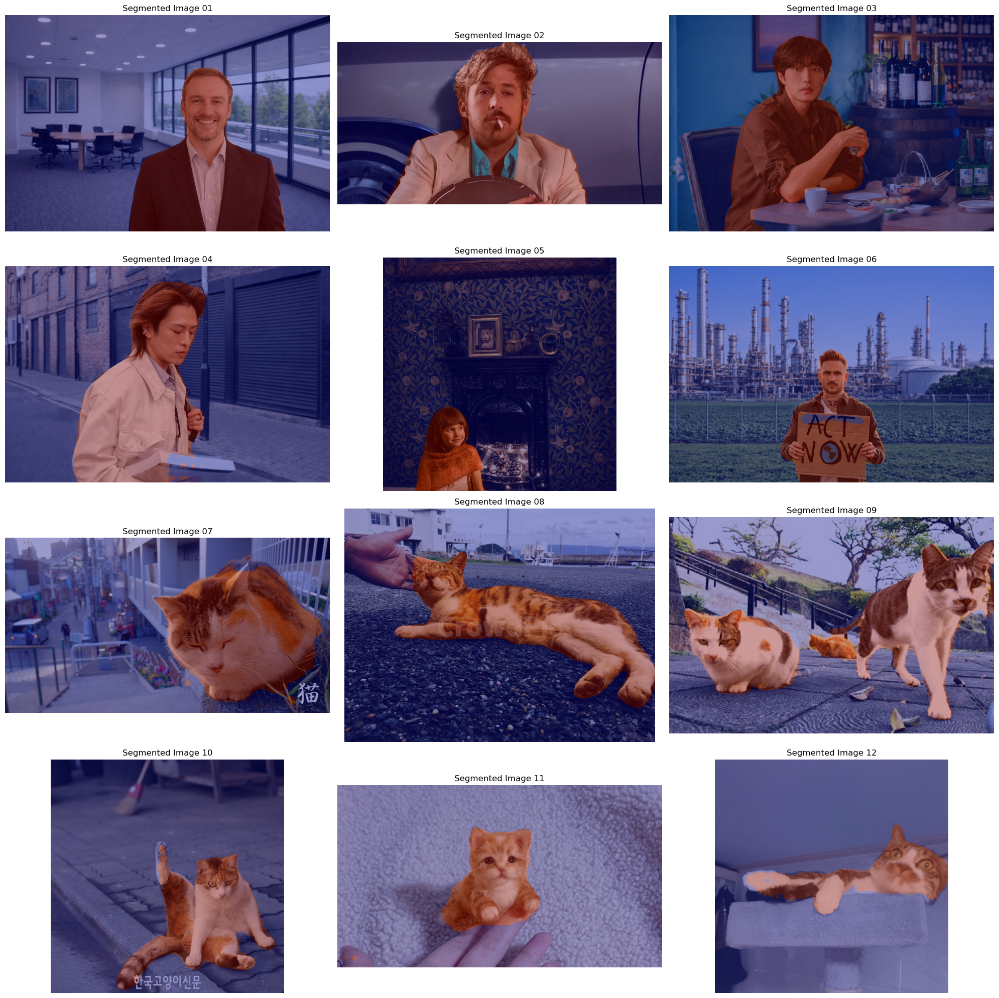

In [5]:
result_list = []
img_mask_list = []

for img in img_list[:6]:
    img_mask, img_show = segmentation(img, 15)
    result_list.append(img_show)
    img_mask_list.append(img_mask)
    
for img in img_list[6:]:
    img_mask, img_show = segmentation(img, 8)
    result_list.append(img_show)
    img_mask_list.append(img_mask)
    
fig, axes = plt.subplots(4, 3, figsize=(20, 20))
for ax, img, i in zip(axes.flatten(), result_list, range(1, 13)):
    ax.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
    ax.set_title(f'Segmented Image {i:02d}')
    ax.axis('off')
plt.tight_layout()
plt.show()

# 4. 배경 Blur 처리 함수 정의하기

In [6]:
def get_segmentation_mask(img_orig, img_mask):

    # (13,13)은 blurring kernel size를 뜻합니다. 다양하게 바꿔보세요.
    img_orig_blur = cv2.blur(img_orig, (15, 15))

    img_mask_color = cv2.cvtColor(img_mask, cv2.COLOR_GRAY2BGR)

    # cv2.bitwise_not(): 이미지가 반전됩니다. 배경이 0 사람이 255 였으나
    # 연산을 하고 나면 배경은 255 사람은 0입니다.
    img_bg_mask = cv2.bitwise_not(img_mask_color)

    # cv2.bitwise_and()을 사용하면 배경만 있는 영상을 얻을 수 있습니다.
    # 0과 어떤 수를 bitwise_and 연산을 해도 0이 되기 때문에
    # 사람이 0인 경우에는 사람이 있던 모든 픽셀이 0이 됩니다. 결국 사람이 사라지고 배경만 남아요!
    img_bg_blur = cv2.bitwise_and(img_orig_blur, img_bg_mask)

    # np.where(조건, 참일때, 거짓일때)
    # 세그멘테이션 마스크가 255인 부분만 원본 이미지 값을 가지고 오고
    # 아닌 영역은 블러된 이미지 값을 사용합니다.
    img_concat = np.where(img_mask_color==255, img_orig, img_bg_blur)

    return img_concat

# 5. 테스트 이미지 배경 Blur 처리

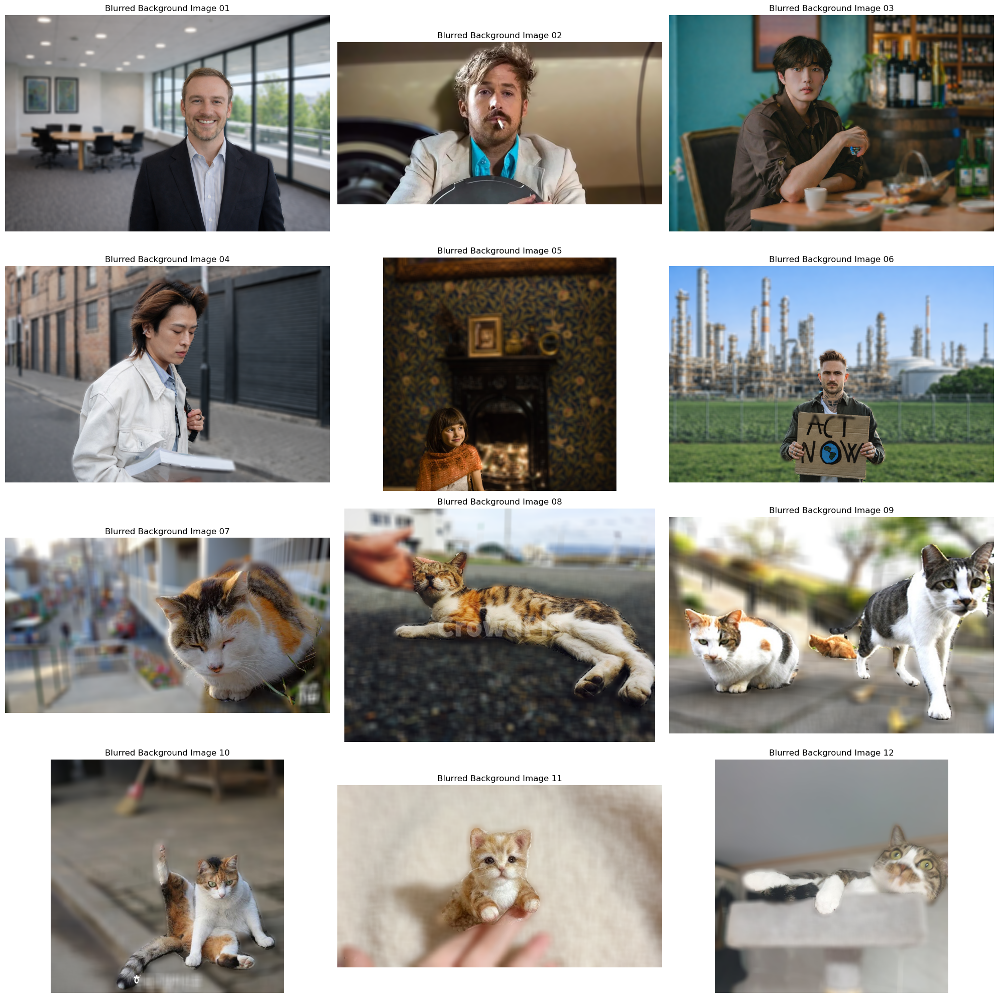

In [7]:
concat_list = []

for img, img_mask in zip(img_list, img_mask_list):
    img_concat = get_segmentation_mask(img, img_mask)
    concat_list.append(img_concat)

fig, axes = plt.subplots(4, 3, figsize=(20, 20))
for ax, img, i in zip(axes.flatten(), concat_list, range(1, 13)):
    ax.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
    ax.set_title(f'Blurred Background Image {i:02d}')
    ax.axis('off')
plt.tight_layout()
plt.show()

# 6. 고양이 크로마키 배경 합성 함수 정의

In [8]:
def change_background(cat_img):

    model = deeplabv3_resnet101(pretrained=True).eval()

    transform = T.Compose([
        T.ToPILImage(),
        T.Resize((520, 520)),  # 모델 입력 크기
        T.ToTensor(),
    ])

    input_tensor = transform(cat_img).unsqueeze(0)

    with torch.no_grad():
        output = model(input_tensor)["out"][0]
        output_predictions = output.argmax(0).byte().cpu().numpy()

    print(f"추론 마스크 크기 (Before Resize): {output_predictions.shape}")

    # 마스크를 원본 크기로 Resize
    output_predictions_resized = cv2.resize(output_predictions, (cat_img.shape[1], cat_img.shape[0]), interpolation=cv2.INTER_NEAREST)

    print(f"추론 마스크 크기 (After Resize): {output_predictions_resized.shape}")

    unique_classes = np.unique(output_predictions_resized)
    print(f"예측된 클래스 ID: {unique_classes}")

    target_class_id = unique_classes[-1]

    seg_map = (output_predictions_resized == target_class_id)
    img_mask = seg_map.astype(np.uint8) * 255

    # 배경을 고양이 이미지 크기에 맞춤
    sand_img_resized = cv2.resize(sand_img, (cat_img.shape[1], cat_img.shape[0]))

    # 고양이 부분만 남기고 배경 적용
    img_mask_color = cv2.cvtColor(img_mask, cv2.COLOR_GRAY2BGR)  # 3채널 변환
    result_img = np.where(img_mask_color == 255, cat_img, sand_img_resized)  # 마스크 기반 합성

    return result_img

# 7. 고양이 이미지 크로마키 배경 합성

추론 마스크 크기 (Before Resize): (520, 520)
추론 마스크 크기 (After Resize): (408, 757)
예측된 클래스 ID: [0 8]
추론 마스크 크기 (Before Resize): (520, 520)
추론 마스크 크기 (After Resize): (520, 692)
예측된 클래스 ID: [ 0  5  8 15]
추론 마스크 크기 (Before Resize): (520, 520)
추론 마스크 크기 (After Resize): (320, 480)
예측된 클래스 ID: [0 8]
추론 마스크 크기 (Before Resize): (520, 520)
추론 마스크 크기 (After Resize): (440, 440)
예측된 클래스 ID: [0 8]
추론 마스크 크기 (Before Resize): (520, 520)
추론 마스크 크기 (After Resize): (308, 548)
예측된 클래스 ID: [0 8]
추론 마스크 크기 (Before Resize): (520, 520)
추론 마스크 크기 (After Resize): (640, 640)
예측된 클래스 ID: [0 8]


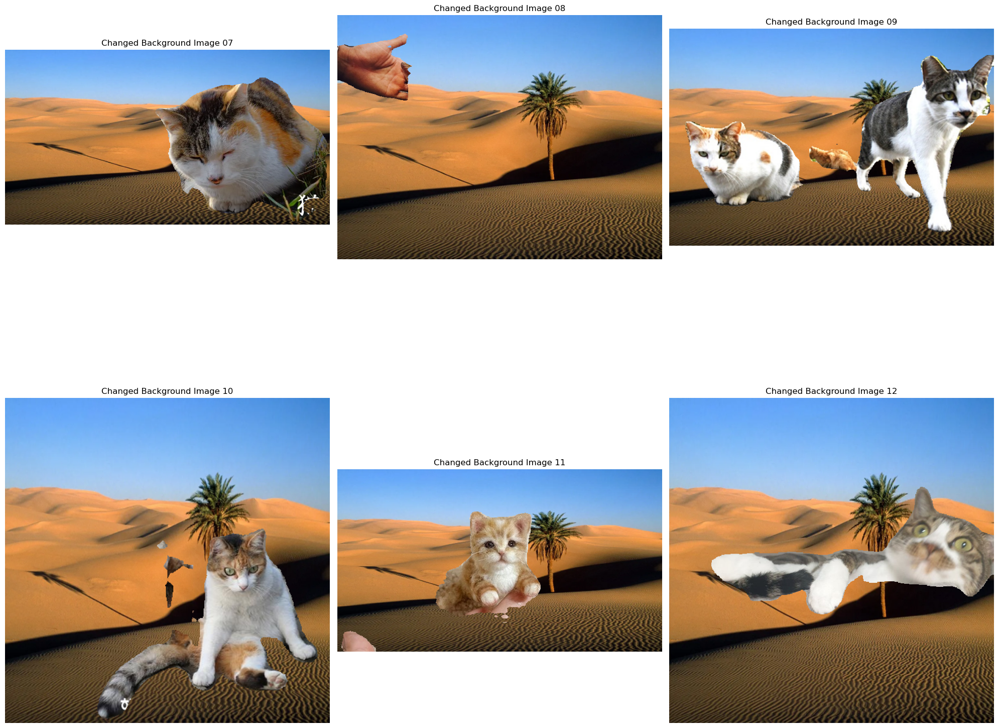

In [9]:
concat_list = []

sand_img = cv2.cvtColor(sand_img, cv2.COLOR_BGR2RGB)

for img, img_mask in zip(img_list[6:], img_mask_list[6:]):
    result_img = change_background(img)
    concat_list.append(result_img)

fig, axes = plt.subplots(2, 3, figsize=(20, 20))

for ax, img, i in zip(axes.flatten(), concat_list, range(7, 13)):
    ax.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
    ax.set_title(f'Changed Background Image {i:02d}')
    ax.axis('off')
    
plt.tight_layout()
plt.show()

# 8. 결과물에서 문제점 찾기

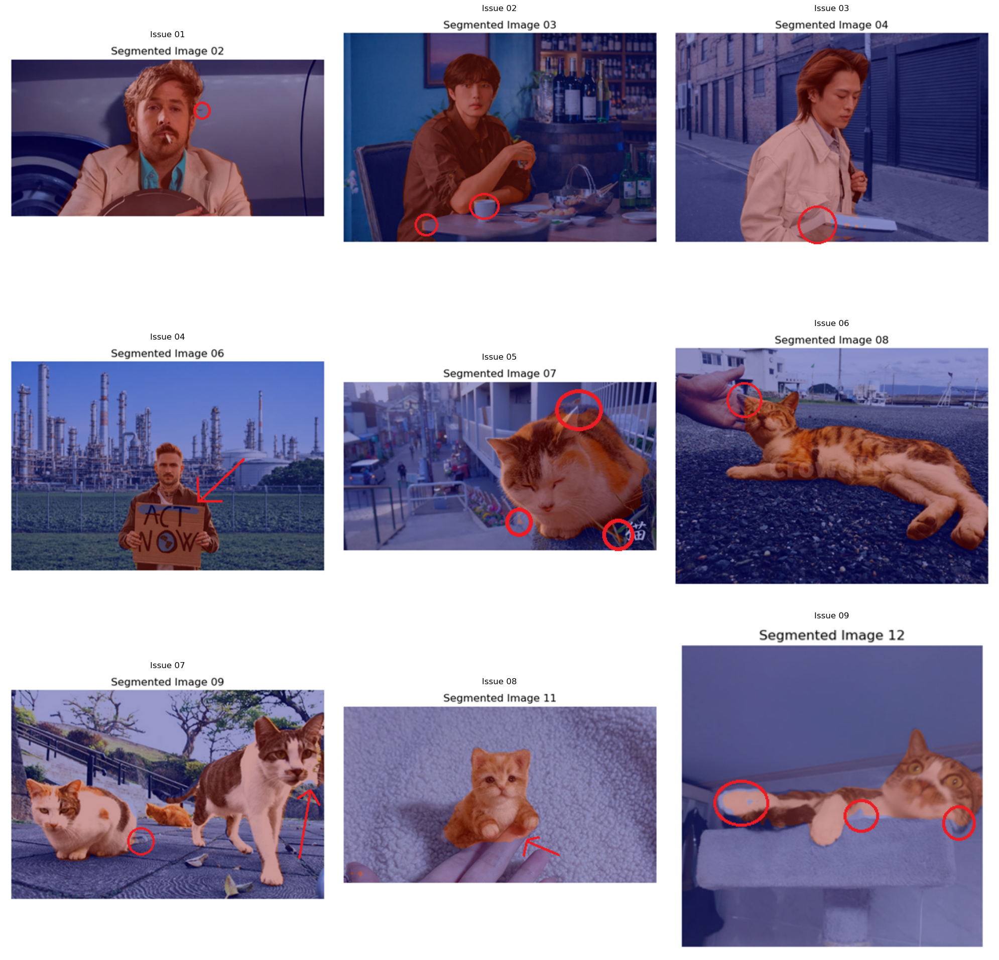

In [10]:
issue_list = []

for i in range(1, 10):
    img_path = f'issues/issue{i:02d}.png'
    issue_list.append(cv2.imread(img_path))

fig, axes = plt.subplots(3, 3, figsize=(20, 20))
for ax, img, i in zip(axes.flatten(), issue_list, range(1, 13)):
    ax.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
    ax.set_title(f'Issue {i:02d}')
    ax.axis('off')
plt.tight_layout()
plt.show()

1. [Segmented Image 02] 머리카락이 인식되지 않았다. 
2. [Segmented Image 03] 테이블 모서리와 옷이 명확히 구분되지 않았고, 팔과 컵이 겹쳐진 부분이 명확히 구분되지 않았다.  
3. [Segmented Image 04] 사람이 들고 있는 종이가 옷과 같은 색깔이어서 종이를 사람의 일부로 잘못 인식하였다. 
4. [Segmented Image 06] 사람이 들고 있는 판넬의 윗부분이 옷과 구분되며 사람의 일부로 인식되지 않았고, 나머지 부분은 사람의 일부로 포함되었다. 
5. [Segmented Image 07] 고양이 귀 끄트머리가 잘렸고, 고양이와 관계없는 작은 선이나 다른 작은 물체가 고양이의 일부로 인식되었다.  
6. [Segmented Image 08] 고양이 귀 끄트머리가 사람 손과 비슷한 색깔이어서 잘렸다. 
7. [Segmented Image 09] 고양이 꼬리가 인식되지 않았고, 고양이의 얼굴 부위 흰 털과 배경의 흰색이 구분되지 않아 배경까지 고양이로 인식되었다. 
8. [Segmented Image 11] 사람 손가락의 일부가 고양이로 인식되었다.  
9. [Segmented Image 12] 벽지가 고양이 털과 같은 흰 색이어서 일부분이 잘렸고, 다른 부위도 털 끄트머리가 주변부와 비슷한 색깔일 때 잘렸다. 

# 9. 해결방안

## 9-1. 경계 품질을 직접 올리는 학습 목표로 바꾸기 (Boundary-aware)

### **[Boundary loss / Edge supervision 추가]**

* **아이디어**: mIoU는 내부 면적을 잘 맞추는 데 유리하지만, 인물모드 품질은 **경계(특히 머리카락, 어깨선)**가 핵심이다.
* **메커니즘**

  1. GT 마스크에서 **경계 맵(edge map)**을 뽑음(예: morphological gradient, Sobel, Canny 등).
  2. 모델이 **(segmentation logits)** 외에 **(boundary logits)**도 예측하도록 헤드를 하나 추가(멀티헤드).
  3. 손실을 `L = L_seg + λ * L_edge` 형태로 합침. `L_edge`로는 BCE/Dice/Focal 등을 사용.
  4. 경계 중심 지표로 평가도 같이 수행. Boundary F-score(BF1), Trimap IoU 같은 지표를 함께 고려.
     
* **효과**: 경계가 흐려져서 배경이 인물로 새어 들어오거나(bleeding), 인물이 배경으로 깎이는 문제를 줄임.

---

## 9-2. "하드 마스크" 대신 "소프트 알파(매팅)"로 품질을 완성하기

### **[Matting(알파 매트) 2단계 파이프라인]**

* **아이디어**: 세그멘테이션은 본질적으로 이진(0/1)이라 **머리카락처럼 반투명/가느다란 구조**에 약하다. 인물모드 품질은 사실상 **image matting(알파 추정)** 문제가 더 맞다.
* **메커니즘**

  1. 1단계: 세그멘테이션으로 **대략적인 trimap** 생성 → Foreground / Background / Unknown(경계 주변 띠)
  2. 2단계: Matting 네트워크(또는 matting 헤드)가 **Unknown 영역에서 알파(0~1)**를 회귀
  3. 블러 합성 시: `I = α*person + (1-α)*blurred_bg`로 자연스럽게 합성

* **효과**: 머리카락/옷 경계가 "딱 잘린 느낌"에서 "자연스럽게 섞이는 느낌"으로 바뀜.

---

## 9-3. 멀티스케일/고해상도 특징을 강화하기 (작은 디테일 보존)

### **[DeepLabv3+류(ASPP) + 고해상도 디코더 강화]**

* **아이디어**: 작은 구조(머리카락, 이어폰 줄, 자켓 라펠)는 “해상도”가 생명이다.
* **메커니즘**

  * 백본 출력 stride를 줄이거나(출력 해상도↑),
  * 디코더에서 low-level feature(초기층 특징)를 적극적으로 합쳐서 경계 복원.
    
* **효과**: 얇은 물체/경계가 덜 사라짐.

---

## 9-4. 클래스 불균형/애매한 픽셀을 다루는 Loss로 바꾸기

### **[Focal Loss / Dice Loss / Tversky Loss 조합]**

* **문제**: 인물 픽셀이 배경보다 적거나, ‘경계 주변’은 극도로 애매해서 학습이 흔들림.
* **메커니즘**

  * CE만 쓰지 말고 `CE + Dice` 또는 `Focal + Dice` 같이 섞기
  * Tversky는 FP/FN 페널티를 비대칭으로 줄 수 있어, '배경이 인물로 새는 것'을 더 강하게 벌주거나 '인물이 깎이는 것'을 더 강하게 벌주는 식의 목표를 명시할 수 있음.

* **효과**: 얇은 구조와 경계에서의 오류가 줄어드는 경우가 많음.

---

## 9-5. 데이터/증강을 "실제 실패 케이스"에 맞게 설계하기

### **["인물모드 실패 케이스"를 직접 만드는 증강]**

* **아이디어**: 현재 모델이 잘 틀리는 이미지(경계/유사색 배경/반사)를 모아서 학습 배치에 더 자주 넣음.
* **메커니즘(예시)**

  * 배경이 복잡한 실내(책장, 와인병, 선반) 합성/증강
  * 조명 변화/화이트밸런스 변화
  * 모션 블러(손떨림)
  * 얇은 물체(이어폰 줄, 안경테) 강조 데이터 추가
    
* **효과**: 모델이 “실제 서비스에서 망하는 상황”을 학습 중에 미리 겪게 함.

---

## 9-6. 후처리로 "세그멘테이션의 부정확성"을 영상/사진 특성으로 보정하기

### **[DenseCRF / Bilateral solver (경계 정렬 후처리)]**

* **아이디어**: 픽셀 라벨이 영상의 색/에지 구조를 따르도록 "정렬"해줌.
* **메커니즘**

  * unary = 모델 logits
  * pairwise = 색/거리 기반(비슷한 색이면 같은 라벨 선호)
  * 최적화로 마스크를 영상 경계에 맞춰 재정렬
    
* **효과**: 경계가 이미지의 실제 에지에 더 붙습니다.
* **주의**: 머리카락처럼 배경과 색이 비슷하면 오히려 악화될 수도 있어, 이 경우는 2) 매팅 방식이 더 강합니다.

---

## 9-7. 깊이(Depth)를 같이 쓰는 멀티모달/멀티태스크 (가능하면 강력)

### **[Depth + Segmentation 멀티태스크 + depth 기반 블러 합성]**

* **문제**: 세그로 사람/배경만 나누면 배경 전체가 동일하게 블러 → 부자연스러움.
* **메커니즘**

  1. 공유 백본
  2. 세그 헤드 + 깊이 헤드(깊이는 self-supervised도 가능)
  3. 깊이 경계(Depth discontinuity)가 인물 경계와 잘 맞는 경우가 많아, 경계 학습이 보조됨
  4. depth에 따라 blur kernel 크기를 바꿔서 더 자연스럽게 인물 구현
     
* **효과**: 배경이 복잡하고 색이 비슷해도 "거리 단서"로 분리 가능.

---


# 10. 회고

- 아직 여러 가지 기법의 이론적/기술적 부분을 완벽히 이해하기는 어렵다.
- 아이디어가 무엇이고, 어떤 효과가 있는지를 중심으로 직관적으로 이해하고 활용하는 것을 먼저 해봐야겠다.
- 문제점이 아예 영역이 구분되었던 다른 기술로 인해 해결되기도 한다는 점이 흥미로웠고, 여러 기법들의 구체적인 설계이론을 알아보고 싶다. 